# EDA (Exploratory Data Analysis)

## Importar Librerías

In [1]:
# ===== Librerías ==========================================
import warnings

import numpy as np
import pandas as pd   

# Gráficos
# Matplotlib
import matplotlib.pyplot as plt
# Seaborn
import seaborn as sns
# Plotly
import plotly.express as px # Importing Plotly Express for high-level, easy-to-use interactive visualizations
import plotly.graph_objects as go # Importing Plotly Graph Objects for more fine-grained control over visualizations
from plotly.subplots import make_subplots # Multiple graphs in a figure
from plotly.offline import iplot, init_notebook_mode
init_notebook_mode()

# Importando itertools para generar combinaciones de columnas
import itertools

# Importando la función seasonal_decompose para la descomposición de series temporales
from statsmodels.tsa.seasonal import seasonal_decompose

# ===== Ajustes de visualización =============================
#Configuramos para que las gráficas se vean dentro del cuaderno
%matplotlib inline
# Establecemos el tamaño de la fuente en los gráficos
plt.rc('font', size=12)
# Ajustamos el tamaño de las figuras
plt.rc('figure', figsize=(12, 5))
#plt.rcParams['figure.figsize'] = [4, 4]

# Configuration to set so that all the Seaborn figures come out with this size
%config Inlinebackend.figure_format= 'retina'

# Set the Seaborn context to "poster" for larger text and figures
sns.set_context("poster")

# Set the default figure size for Seaborn plots
sns.set(rc={"figure.figsize": (12., 6.)})

# Set the Seaborn style to "whitegrid" for a white background with gridlines
sns.set_style("whitegrid")

## Importar y Describir el Conjunto de Datos

In [2]:
# Load the dataset
df = pd.read_csv('./datasets/kaggle/spotify_cleaned_dataset.csv')
df.shape

(20594, 24)

In [3]:
df.head()

,Artist,Track,Album,Album_type,Danceability,Energy,Loudness,Speechiness,Acousticness,Instrumentalness,...,Title,Channel,Views,Likes,Comments,Licensed,official_video,Stream,EnergyLiveness,most_playedon
0,Gorillaz,Feel Good Inc.,Demon Days,album,0.818,0.705,-6.679,0.1770,0.008360,0.002330,...,Gorillaz - Feel Good Inc. (Official Video),Gorillaz,693555221.0,6220896.0,169907.0,True,True,1.040235e+09,1.150082,Spotify
1,Gorillaz,Rhinestone Eyes,Plastic Beach,album,0.676,0.703,-5.815,0.0302,0.086900,0.000687,...,Gorillaz - Rhinestone Eyes [Storyboard Film] (...,Gorillaz,72011645.0,1079128.0,31003.0,True,True,3.100837e+08,15.183585,Spotify
2,Gorillaz,New Gold (feat. Tame Impala and Bootie Brown),New Gold (feat. Tame Impala and Bootie Brown),single,0.695,0.923,-3.930,0.0522,0.042500,0.046900,...,Gorillaz - New Gold ft. Tame Impala & Bootie B...,Gorillaz,8435055.0,282142.0,7399.0,True,True,6.306347e+07,7.956897,Spotify
3,Gorillaz,On Melancholy Hill,Plastic Beach,album,0.689,0.739,-5.810,0.0260,0.000015,0.509000,...,Gorillaz - On Melancholy Hill (Official Video),Gorillaz,211754952.0,1788577.0,55229.0,True,True,4.346636e+08,11.546875,Spotify
4,Gorillaz,Clint Eastwood,Gorillaz,album,0.663,0.694,-8.627,0.1710,0.025300,0.000000,...,Gorillaz - Clint Eastwood (Official Video),Gorillaz,618480958.0,6197318.0,155930.0,True,True,6.172597e+08,9.942693,Youtube


In [4]:
df.sample(5)

,Artist,Track,Album,Album_type,Danceability,Energy,Loudness,Speechiness,Acousticness,Instrumentalness,...,Title,Channel,Views,Likes,Comments,Licensed,official_video,Stream,EnergyLiveness,most_playedon
1913,Shekhar Ravjiani,The Break Up Mashup,The Break Up Mashup,single,0.251,0.604,-5.622,0.0431,0.1710,0.000002,...,The Break Up MashUp Full Video Song 2014 | DJ ...,T-Series,62917627.0,773549.0,13359.0,True,True,13047107.0,4.910569,Youtube
15316,Migos,Walk It Talk It,Culture II,album,0.907,0.633,-5.145,0.1840,0.0876,0.000003,...,Migos - Walk It Talk It ft. Drake (Official Vi...,MigosVEVO,402051856.0,3589336.0,111565.0,True,True,675438899.0,5.971698,Spotify
7153,Alceu Valença,Anunciação,Melim: Melhores do Meu 2020,compilation,0.539,0.745,-7.854,0.0278,0.4510,0.000235,...,Alceu Valenca - Anunciação,Alceu Valença,86922471.0,633778.0,14966.0,False,True,85710030.0,7.233010,Youtube
3294,Péricles,Graveto - Ao Vivo,"Pagode Do Pericão II, Pt. 2 (Ao Vivo)",album,0.550,0.698,-7.224,0.0367,0.6650,0.000000,...,Péricles - Graveto | Pagode Do Pericão 2 (Víde...,Canal do Pericão,260818.0,3152.0,101.0,True,True,7945190.0,0.973501,Spotify
17458,LANY,Mean It,~how i'm feeling~,album,0.747,0.450,-8.543,0.0919,0.0407,0.000000,...,Lauv & LANY - Mean It [Official Video],Lauv,76707474.0,757135.0,11959.0,True,True,290146116.0,2.647059,Spotify


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20594 entries, 0 to 20593
Data columns (total 24 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Artist            20594 non-null  object 
 1   Track             20594 non-null  object 
 2   Album             20594 non-null  object 
 3   Album_type        20594 non-null  object 
 4   Danceability      20594 non-null  float64
 5   Energy            20594 non-null  float64
 6   Loudness          20594 non-null  float64
 7   Speechiness       20594 non-null  float64
 8   Acousticness      20594 non-null  float64
 9   Instrumentalness  20594 non-null  float64
 10  Liveness          20594 non-null  float64
 11  Valence           20594 non-null  float64
 12  Tempo             20594 non-null  float64
 13  Duration_min      20594 non-null  float64
 14  Title             20594 non-null  object 
 15  Channel           20594 non-null  object 
 16  Views             20594 non-null  float6

### Contexto

`'valence'`

In the context of music, **valence** refers to the emotional quality or mood of a piece of music, particularly whether it evokes positive or negative emotions. It is often used in music psychology and studies involving emotional responses to music.

- **High valence:** Music with a happy, uplifting, or positive emotional tone. Examples might include upbeat pop songs or bright classical compositions.
    
- **Low valence:** Music with a sad, melancholic, or negative emotional tone. Examples could be somber ballads or dark, brooding instrumental pieces.
    
Valence is one of the dimensions in the circumplex model of affect, which is often paired with arousal (the intensity or energy level of the music) to describe the emotional response music elicits. For example:

A song with high valence and high arousal might feel joyful and exciting.
A song with low valence and low arousal might feel calm but melancholic.
This concept is widely used in areas like music recommendation systems, therapy, and emotional analysis.

In [6]:
df.describe()

,Danceability,Energy,Loudness,Speechiness,Acousticness,Instrumentalness,Liveness,Valence,Tempo,Duration_min,Views,Likes,Comments,Stream,EnergyLiveness
count,20594.000000,20594.000000,20594.000000,20594.000000,20594.000000,20594.000000,20594.000000,20594.000000,20594.000000,20594.000000,2.059400e+04,2.059400e+04,2.059400e+04,2.059400e+04,20592.000000
mean,0.620102,0.635176,-7.678254,0.096733,0.291391,0.056162,0.193653,0.530077,120.562616,3.742439,9.203740e+07,6.479902e+05,2.684679e+04,1.326446e+08,5.167227
std,0.165504,0.214274,4.639481,0.112182,0.286117,0.193622,0.168832,0.245542,29.588093,2.085211,2.726026e+08,1.773648e+06,1.911751e+05,2.423582e+08,4.117431
min,0.000000,0.000000,-46.251000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000049
25%,0.519000,0.507000,-8.868000,0.035700,0.045200,0.000000,0.094100,0.340000,96.994000,2.996746,1.478284e+06,1.754200e+04,4.060000e+02,1.559098e+07,2.386190
50%,0.638000,0.666000,-6.540500,0.050650,0.193000,0.000002,0.125000,0.538000,119.959000,3.551267,1.331348e+07,1.153155e+05,3.006000e+03,4.730525e+07,4.256881
75%,0.741000,0.798000,-4.935000,0.104000,0.476750,0.000474,0.237000,0.727000,139.923500,4.202163,6.739682e+07,5.000198e+05,1.373675e+04,1.343453e+08,6.822034
max,0.975000,1.000000,0.920000,0.964000,0.996000,1.000000,1.000000,0.993000,243.372000,77.934300,8.079649e+09,5.078865e+07,1.608314e+07,3.386520e+09,59.113924


## Revisión de Valores Nulos

Aunque ya lo vimos mediante el método `.info()` revisamos de nuevo los valores nulos del dataframe.

In [7]:
df.isna().sum()

Artist              0
Track               0
Album               0
Album_type          0
Danceability        0
Energy              0
Loudness            0
Speechiness         0
Acousticness        0
Instrumentalness    0
Liveness            0
Valence             0
Tempo               0
Duration_min        0
Title               0
Channel             0
Views               0
Likes               0
Comments            0
Licensed            0
official_video      0
Stream              0
EnergyLiveness      2
most_playedon       0
dtype: int64

Tan sólo la columna `'EnergyLiveness'` presenta 2 valores nulos.

In [8]:
df[df['EnergyLiveness'].isna()]

,Artist,Track,Album,Album_type,Danceability,Energy,Loudness,Speechiness,Acousticness,Instrumentalness,...,Title,Channel,Views,Likes,Comments,Licensed,official_video,Stream,EnergyLiveness,most_playedon
11824,Natasha Bedingfield,These Words,Unwritten,album,0.0,0.0,0.0,0.0,0.0,0.0,...,Natasha Bedingfield - These Words (Official Vi...,NBedingfieldVEVO,21655597.0,165220.0,7780.0,True,True,110442210.0,NaN,Spotify
13773,White Noise for Babies,Rain in the Early Morning,Soothing Rain for Background Sounds and Natura...,album,0.0,0.0,0.0,0.0,0.0,0.0,...,0,0,0.0,0.0,0.0,0,0,145339552.0,NaN,Spotify


## Revisión de Columnas con Valores Clave

In [9]:
columnas=df.columns.tolist()
columnas

['Artist',
 'Track',
 'Album',
 'Album_type',
 'Danceability',
 'Energy',
 'Loudness',
 'Speechiness',
 'Acousticness',
 'Instrumentalness',
 'Liveness',
 'Valence',
 'Tempo',
 'Duration_min',
 'Title',
 'Channel',
 'Views',
 'Likes',
 'Comments',
 'Licensed',
 'official_video',
 'Stream',
 'EnergyLiveness',
 'most_playedon']

In [10]:
columnas_numericas=df.describe().columns.tolist() # Also, numericals = df.select_dtypes(np.number)
columnas_numericas

['Danceability',
 'Energy',
 'Loudness',
 'Speechiness',
 'Acousticness',
 'Instrumentalness',
 'Liveness',
 'Valence',
 'Tempo',
 'Duration_min',
 'Views',
 'Likes',
 'Comments',
 'Stream',
 'EnergyLiveness']

In [11]:
for i in columnas:
    print("===========================")
    print(f"{df[i].value_counts().head(5)}")

Artist
Gorillaz        10
Thaman S        10
Alan Gomez      10
RÜFÜS DU SOL    10
Bo Burnham      10
Name: count, dtype: int64
Track
El Ultimo Adiós - Varios Artistas Version                     24
Color Esperanza 2020                                          19
Resistiré                                                     14
Y, ¿Si Fuera Ella? - + Es +                                    9
52 Non Stop Dilbar Dilbar Remix(Remix By Kedrock,Sd Style)     9
Name: count, dtype: int64
Album
Greatest Hits                                  30
Hamilton (Original Broadway Cast Recording)    29
Rebelde                                        25
El Ultimo Adiós                                24
Madvillainy                                    24
Name: count, dtype: int64
Album_type
album          14834
single          4973
compilation      787
Name: count, dtype: int64
Danceability
0.687    78
0.671    74
0.626    69
0.647    67
0.585    66
Name: count, dtype: int64
Energy
0.572    59
0.711    57
0.7

## Visualización de Distribuciones de Datos

### Datos Categóricos

In [12]:
not_numericals = df.select_dtypes(np.object_).columns
not_numericals
lst_pies = []
for c in not_numericals:
    counts = df[c].value_counts()
    counts.name = c        
    if len(counts)<=10:
        drawpie = '-> pie'
        lst_pies.append(counts)
    else:
        drawpie = ''
    print(f'{c} ({counts.index.__len__()} unique values)', drawpie)
print(f'\nDibujaremos {len(lst_pies)} pie charts...')

Artist (2074 unique values) 
Track (17717 unique values) 
Album (11854 unique values) 
Album_type (3 unique values) -> pie
Title (18023 unique values) 
Channel (6673 unique values) 
Licensed (3 unique values) -> pie
official_video (3 unique values) -> pie
most_playedon (2 unique values) -> pie

Dibujaremos 4 pie charts...


In [45]:
# We want a subplot for every pie chart
# We want a subplot for every column
total_subplots = len(lst_pies)
cols = 2
rows = (total_subplots // cols) if (total_subplots % cols == 0) else (total_subplots // cols) + 1

# The name of the list will be the subplot title
subplot_titles = [lst_item.name for lst_item in lst_pies]

# Setup subplots
specs = [[{'type':'domain'}] * cols] * rows
fig = make_subplots(
        rows=rows,
        cols=cols,
        subplot_titles=subplot_titles,
        specs=specs,
        print_grid=False)

for i, lst_item in enumerate(lst_pies):
    # basic math to get col and row
    row = i // cols + 1
    col = i % (cols) + 1
    fig.add_trace(
        go.Pie(labels=lst_item.index,
               values=lst_item.values,               
               showlegend=False,
               textposition='inside',
               textinfo='label+percent'),               
         row=row,
         col=col         
    )

fig.update_layout(title="Categorical Variables", title_x=0.5, autosize=True, height=800, width=1024)
fig.show()

### Datos Numéricos

In [18]:
print(columnas_numericas)
    

['Danceability', 'Energy', 'Loudness', 'Speechiness', 'Acousticness', 'Instrumentalness', 'Liveness', 'Valence', 'Tempo', 'Duration_min', 'Views', 'Likes', 'Comments', 'Stream', 'EnergyLiveness']


In [23]:
df.describe()

,Danceability,Energy,Loudness,Speechiness,Acousticness,Instrumentalness,Liveness,Valence,Tempo,Duration_min,Views,Likes,Comments,Stream,EnergyLiveness
count,20594.000000,20594.000000,20594.000000,20594.000000,20594.000000,20594.000000,20594.000000,20594.000000,20594.000000,20594.000000,2.059400e+04,2.059400e+04,2.059400e+04,2.059400e+04,20592.000000
mean,0.620102,0.635176,-7.678254,0.096733,0.291391,0.056162,0.193653,0.530077,120.562616,3.742439,9.203740e+07,6.479902e+05,2.684679e+04,1.326446e+08,5.167227
std,0.165504,0.214274,4.639481,0.112182,0.286117,0.193622,0.168832,0.245542,29.588093,2.085211,2.726026e+08,1.773648e+06,1.911751e+05,2.423582e+08,4.117431
min,0.000000,0.000000,-46.251000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000049
25%,0.519000,0.507000,-8.868000,0.035700,0.045200,0.000000,0.094100,0.340000,96.994000,2.996746,1.478284e+06,1.754200e+04,4.060000e+02,1.559098e+07,2.386190
50%,0.638000,0.666000,-6.540500,0.050650,0.193000,0.000002,0.125000,0.538000,119.959000,3.551267,1.331348e+07,1.153155e+05,3.006000e+03,4.730525e+07,4.256881
75%,0.741000,0.798000,-4.935000,0.104000,0.476750,0.000474,0.237000,0.727000,139.923500,4.202163,6.739682e+07,5.000198e+05,1.373675e+04,1.343453e+08,6.822034
max,0.975000,1.000000,0.920000,0.964000,0.996000,1.000000,1.000000,0.993000,243.372000,77.934300,8.079649e+09,5.078865e+07,1.608314e+07,3.386520e+09,59.113924


In [30]:
# Esto es lo mismo que nos da df.describe() pero puesto de manera más legible
# Crear una lista para almacenar los resultados
estadisticas = []
# Iterar sobre los predictores y calcular las estadísticas
for i, c in enumerate(columnas_numericas):
    minimo = np.min(df.loc[:, c])
    maximo = np.max(df.loc[:, c])
    media = np.mean(df.loc[:, c])
    varianza = np.var(df.loc[:, c])
    # Añadir los resultados a la lista
    estadisticas.append([c, minimo, maximo, media, varianza])

# Crear un DataFrame para mostrar los resultados
df_estadisticas = pd.DataFrame(estadisticas, columns=['Columna', 'Mínimo', 'Máximo', 'Media', 'Varianza'])
# Mostrar el DataFrame
df_estadisticas

,Columna,Mínimo,Máximo,Media,Varianza
0,Danceability,0.000000,9.750000e-01,6.201018e-01,2.739030e-02
1,Energy,0.000000,1.000000e+00,6.351761e-01,4.591122e-02
2,Loudness,-46.251000,9.200000e-01,-7.678254e+00,2.152374e+01
3,Speechiness,0.000000,9.640000e-01,9.673305e-02,1.258419e-02
4,Acousticness,0.000000,9.960000e-01,2.913909e-01,8.185900e-02
5,Instrumentalness,0.000000,1.000000e+00,5.616186e-02,3.748747e-02
6,Liveness,0.000000,1.000000e+00,1.936533e-01,2.850288e-02
7,Valence,0.000000,9.930000e-01,5.300769e-01,6.028812e-02
8,Tempo,0.000000,2.433720e+02,1.205626e+02,8.754128e+02
9,Duration_min,0.000000,7.793430e+01,3.742439e+00,4.347893e+00


In [46]:
columnas_numericas = df.describe().columns.tolist()

# We want a subplot for every column
total_subplots = len(columnas_numericas)
cols = 2
rows = (total_subplots // cols) if (total_subplots % cols == 0) else (total_subplots // cols) + 1

# The name of the list will be the subplot title
subplot_titles = [c for c in columnas_numericas]

# Setup subplots
specs = [[{'type':'histogram'}] * cols] * rows
fig = make_subplots(
        rows=rows,
        cols=cols,
        subplot_titles=subplot_titles,
        specs=specs,
        print_grid=False)

for i, c in enumerate(columnas_numericas):
    # basic math to get col and row
    row = i // cols + 1
    col = i % (cols) + 1    
    color=px.colors.qualitative.Plotly[0]
    # color=px.colors.qualitative.Plotly[1] if (c=='amount') else px.colors.qualitative.Plotly[0]    
    fig.add_trace(go.Histogram(x=df[c], name='', showlegend=False, marker=dict(color=color)),
                  row = row, col = col)    
    
fig.update_layout(title="Numerical Variables", title_x=0.5, autosize=True, height=1200)
fig.show()

## Identificación de Valores Atípicos

Boxplot nos permite identificar valores atípicos que posiblemente hayan quedado ocultos en el histograma.

In [47]:
columnas_numericas = df.describe().columns.tolist()

# We want a subplot for every column
total_subplots = len(columnas_numericas)
cols = 2
rows = (total_subplots // cols) if (total_subplots % cols == 0) else (total_subplots // cols) + 1

# The name of the list will be the subplot title
subplot_titles = [c for c in columnas_numericas]

# Setup subplots
specs = [[{'type':'box'}] * cols] * rows
fig = make_subplots(
        rows=rows,
        cols=cols,
        subplot_titles=subplot_titles,
        specs=specs,
        print_grid=False)

for i, c in enumerate(columnas_numericas):
    # basic math to get col and row
    row = i // cols + 1
    col = i % (cols) + 1
    color=px.colors.qualitative.Plotly[0]
    fig.add_trace(go.Box(x=df[c], name='', showlegend=False, marker=dict(color=color)),
                  row = row, col = col)

fig.update_layout(title="Boxplot of Numerical Variables", title_x=0.5, autosize=True, height=1200)

fig.show()

Pero Boxplot sólo ayuda a identificar valores atípicos, pero no dice nada sobre la densidad (i.e. si son muchos o pocos). Para eso necesitaremos los Violinplot. Normalmente Box y Violin van de la mano.

In [56]:
columnas_numericas = df.describe().columns.tolist()

# We want a subplot for every column
total_subplots = len(columnas_numericas)
cols = 2
rows = (total_subplots // cols) if (total_subplots % cols == 0) else (total_subplots // cols) + 1

# The name of the list will be the subplot title
subplot_titles = [c for c in columnas_numericas]

# Setup subplots
specs = [[{'type':'violin'}] * cols] * rows
fig = make_subplots(
        rows=rows,
        cols=cols,
        subplot_titles=subplot_titles,
        specs=specs,
        print_grid=False)

data = []
for i, c in enumerate(columnas_numericas):
    # basic math to get col and row
    row = i // cols + 1
    col = i % (cols) + 1
    color=px.colors.qualitative.Plotly[0]
    # color=px.colors.qualitative.Plotly[1] if (c=='amount') else px.colors.qualitative.Plotly[0]
    data.append(go.Violin(x=df[c], showlegend=False, marker=dict(color=color)))

fig.add_traces(data, rows=[1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8], cols=[1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1])

fig.update_yaxes(showticklabels=False)

fig.update_layout(title="Violinplot of Numerical Variables", title_x=0.5, autosize=True, height=1200)

fig.show()   

## Gráficos de Dispersión

In [69]:
# sns.pairplot(cash_orig)
dimensions = []
for c in df.describe().columns.tolist():
    dimensions.append(dict(label=c,
                              values=df[c]))
    

fig = go.Figure(data=go.Splom(
               dimensions=dimensions,
               showupperhalf=False,
               diagonal_visible=False,
               opacity=0.2
               ))

fig.update_yaxes(showticklabels=False, visible=False)
# fig.update_xaxes(showticklabels=False)
# fig.update_yaxes(visible=False)
# fig.update_layout(
#     scene = dict(
#         xaxis = dict(visible=False),
#         yaxis = dict(visible=False),
#         zaxis =dict(visible=False)
#         )
#     )

fig.update_layout(
    width=1200,
    height=1024,
    title='Gráficos de Dispersión',
    title_x = 0.5    
)

fig.show()

Podemos mostrar alguna de estas gráficas de dispersión más en detalle, y con línea de tendencia.

In [76]:
# Gráficos de dispersión con línea de tendencia para todas las combinaciones de columnas numéricas
for c1, c2 in itertools.combinations(columnas_numericas, 2):
    fig = px.scatter(df, x=c1, y=c2, opacity=0.2,
    title=f'Gráfico de dispersión de {c1} vs {c2} con línea de tendencia',trendline="ols") # Agregar línea de tendencia (OLS)
    # Cambiar el color de la línea de tendencia a rojo
    fig.update_traces(line=dict(color='red', width=3)) # Color y ancho de la línea de tendencia
    fig.update_traces(line=dict(color='red'), selector=dict(mode='lines')) #Cambiar el color de la línea de tendencia
    fig.update_layout(height=500)
    fig.show()
    break

## Correlación entre Variables Numéricas

In [208]:
df.describe()

,Danceability,Energy,Loudness,Speechiness,Acousticness,Instrumentalness,Liveness,Valence,Tempo,Duration_min,Views,Likes,Comments,Stream,EnergyLiveness
count,20594.000000,20594.000000,20594.000000,20594.000000,20594.000000,20594.000000,20594.000000,20594.000000,20594.000000,20594.000000,2.059400e+04,2.059400e+04,2.059400e+04,2.059400e+04,20592.000000
mean,0.620102,0.635176,-7.678254,0.096733,0.291391,0.056162,0.193653,0.530077,120.562616,3.742439,9.203740e+07,6.479902e+05,2.684679e+04,1.326446e+08,5.167227
std,0.165504,0.214274,4.639481,0.112182,0.286117,0.193622,0.168832,0.245542,29.588093,2.085211,2.726026e+08,1.773648e+06,1.911751e+05,2.423582e+08,4.117431
min,0.000000,0.000000,-46.251000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000049
25%,0.519000,0.507000,-8.868000,0.035700,0.045200,0.000000,0.094100,0.340000,96.994000,2.996746,1.478284e+06,1.754200e+04,4.060000e+02,1.559098e+07,2.386190
50%,0.638000,0.666000,-6.540500,0.050650,0.193000,0.000002,0.125000,0.538000,119.959000,3.551267,1.331348e+07,1.153155e+05,3.006000e+03,4.730525e+07,4.256881
75%,0.741000,0.798000,-4.935000,0.104000,0.476750,0.000474,0.237000,0.727000,139.923500,4.202163,6.739682e+07,5.000198e+05,1.373675e+04,1.343453e+08,6.822034
max,0.975000,1.000000,0.920000,0.964000,0.996000,1.000000,1.000000,0.993000,243.372000,77.934300,8.079649e+09,5.078865e+07,1.608314e+07,3.386520e+09,59.113924


In [209]:
numericals = df.select_dtypes(np.number)
numericals.head()

,Danceability,Energy,Loudness,Speechiness,Acousticness,Instrumentalness,Liveness,Valence,Tempo,Duration_min,Views,Likes,Comments,Stream,EnergyLiveness
0,0.818,0.705,-6.679,0.1770,0.008360,0.002330,0.6130,0.772,138.559,3.710667,693555221.0,6220896.0,169907.0,1.040235e+09,1.150082
1,0.676,0.703,-5.815,0.0302,0.086900,0.000687,0.0463,0.852,92.761,3.336217,72011645.0,1079128.0,31003.0,3.100837e+08,15.183585
2,0.695,0.923,-3.930,0.0522,0.042500,0.046900,0.1160,0.551,108.014,3.585833,8435055.0,282142.0,7399.0,6.306347e+07,7.956897
3,0.689,0.739,-5.810,0.0260,0.000015,0.509000,0.0640,0.578,120.423,3.897783,211754952.0,1788577.0,55229.0,4.346636e+08,11.546875
4,0.663,0.694,-8.627,0.1710,0.025300,0.000000,0.0698,0.525,167.953,5.682000,618480958.0,6197318.0,155930.0,6.172597e+08,9.942693


In [210]:
corr = numericals.corr()
display(corr)

,Danceability,Energy,Loudness,Speechiness,Acousticness,Instrumentalness,Liveness,Valence,Tempo,Duration_min,Views,Likes,Comments,Stream,EnergyLiveness
Danceability,1.000000,0.237554,0.354298,0.210059,-0.279212,-0.319717,-0.084534,0.465989,-0.062556,-0.087606,0.088182,0.098631,0.043582,0.073570,0.219954
Energy,0.237554,1.000000,0.744161,0.065557,-0.656924,-0.310084,0.173544,0.388401,0.158545,0.023303,0.066014,0.061376,0.043943,0.042948,0.384829
Loudness,0.354298,0.744161,1.000000,0.034498,-0.547698,-0.545410,0.086716,0.311189,0.143624,0.011182,0.117790,0.123520,0.058983,0.120238,0.306866
Speechiness,0.210059,0.065557,0.034498,1.000000,-0.077373,-0.110622,0.085404,0.058925,0.038530,-0.050419,-0.014457,0.005823,0.007294,-0.021778,-0.012601
Acousticness,-0.279212,-0.656924,-0.547698,-0.077373,1.000000,0.274340,-0.040251,-0.198494,-0.129348,-0.028644,-0.072956,-0.080497,-0.052861,-0.102319,-0.301411
Instrumentalness,-0.319717,-0.310084,-0.545410,-0.110622,0.274340,1.000000,-0.060132,-0.270560,-0.076246,-0.006711,-0.077478,-0.077586,-0.031127,-0.091950,-0.118782
Liveness,-0.084534,0.173544,0.086716,0.085404,-0.040251,-0.060132,1.000000,0.031254,0.007730,-0.004495,-0.019435,-0.026565,-0.014331,-0.041064,-0.525830
Valence,0.465989,0.388401,0.311189,0.058925,-0.198494,-0.270560,0.031254,1.000000,0.091974,-0.051427,0.034123,0.010048,0.016780,-0.013309,0.251276
Tempo,-0.062556,0.158545,0.143624,0.038530,-0.129348,-0.076246,0.007730,0.091974,1.000000,-0.013140,-0.000010,0.003824,0.008435,0.002985,0.067129
Duration_min,-0.087606,0.023303,0.011182,-0.050419,-0.028644,-0.006711,-0.004495,-0.051427,-0.013140,1.000000,0.022175,0.006320,-0.001214,-0.011151,0.006206


<Axes: >

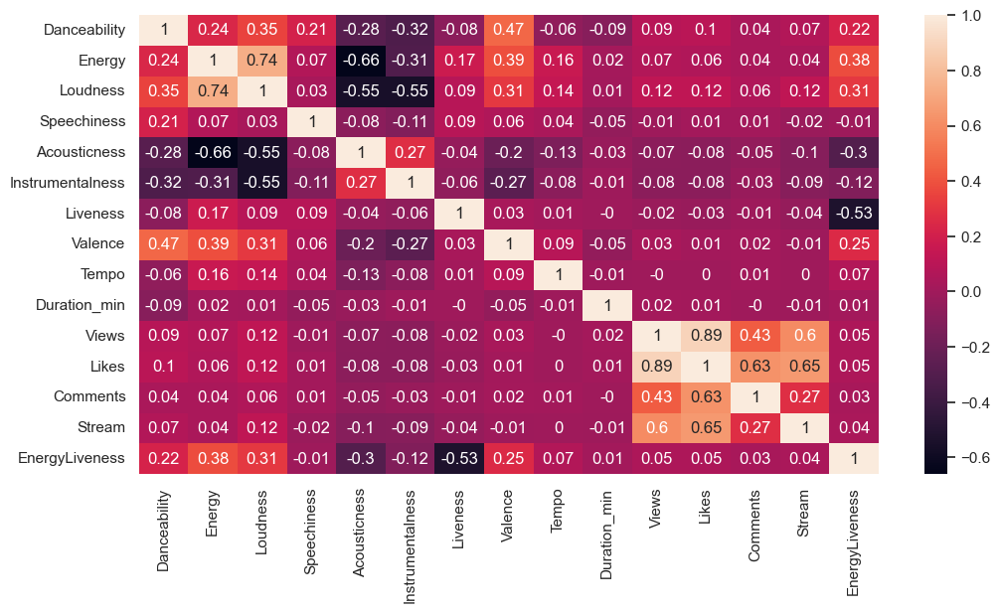

In [214]:
# Create a heatmap to visualize the correlation matrix
sns.heatmap(corr.round(2), annot=True)

## Transformaciones y Extracción de Características (_Feature extraction_)

Las columnas `'Licensed'` y `'official_video'`, de tipo `str`, presentan valores mixtos en el sentido de que había mezclados `True`, `False` y `0`. Investigaremos los motivos y procederemos al tratamiento.

### Licensed

In [ ]:
counts = df.Licensed.value_counts()
counts
# for idx in counts.index:
#     print(f'\"{idx}\"')

Licensed
True     14060
False     6065
0          469
Name: count, dtype: int64

In [ ]:
subset = ['Artist','Track','Album','Album_type','Title','Licensed','official_video','most_playedon']
df[df['Licensed']=='0'][subset].sample(20)
df[df['Licensed']=='0']['Artist'].value_counts().sample(20)

Artist
Alejandro Fernández                         1
José Feliciano                              1
Peter Groeger                               1
Mc IG                                       1
Patricio Rey y sus Redonditos de Ricota     1
Daniel Hope                                 2
Kailash Kher                                1
Mandy Moore                                 1
Juan Luis Guerra 4.40                       2
M.I.A.                                      1
Vishal-Shekhar                              1
S. P. Balasubrahmanyam                      1
Sir Neville Marriner                        2
Wolfgang Amadeus Mozart                     2
Hector & Tito                               9
Matheus & Kauan                            10
Vijay Prakash                               1
Herbert von Karajan                         1
Mr.Kitty                                    1
TOMORROW X TOGETHER                         1
Name: count, dtype: int64

In [ ]:
df[(df['Licensed']=='0') & (df['Artist']=='Jimi Hendrix')][subset].sample()

,Artist,Track,Album,Album_type,Title,Licensed,official_video,most_playedon
2540,Jimi Hendrix,Voodoo Child (Slight Return),Electric Ladyland,album,0,0,0,Spotify


In [ ]:
df[(df['Licensed']!='0') & (df['Artist']=='Jimi Hendrix')][subset].sample(5)

,Artist,Track,Album,Album_type,Title,Licensed,official_video,most_playedon
2543,Jimi Hendrix,Crosstown Traffic,Electric Ladyland,album,The Jimi Hendrix Experience - Crosstown Traffic,False,False,Spotify
2541,Jimi Hendrix,The Wind Cries Mary,Are You Experienced,album,Jimi Hendrix - The Wind Cries Mary(live in Sto...,False,False,Spotify
2539,Jimi Hendrix,Hey Joe,Are You Experienced,album,The Jimi Hendrix Experience - Hey Joe (Officia...,True,True,Spotify
2537,Jimi Hendrix,Little Wing,Axis: Bold As Love,album,"Jimi Hendrix ""Little wing"" GR 012/21 (Official...",True,True,Spotify
2542,Jimi Hendrix,Castles Made of Sand,Axis: Bold As Love,album,Castles Made of Sand,True,True,Spotify


In [ ]:
df[(df['Licensed']=='0') & (df['Artist']=='Juan Luis Guerra 4.40')][subset].sample()

,Artist,Track,Album,Album_type,Title,Licensed,official_video,most_playedon
8126,Juan Luis Guerra 4.40,La Bilirrubina - En Vivo Estadio Olímpico De R...,Asondeguerra Tour (En Vivo Estadio Olímpico De...,album,0,0,0,Spotify


In [ ]:
df[(df['Licensed']!='0') & (df['Artist']=='Juan Luis Guerra 4.40')][subset].sample(5)

,Artist,Track,Album,Album_type,Title,Licensed,official_video,most_playedon
8119,Juan Luis Guerra 4.40,Bachata En Fukuoka,Asondeguerra,album,Juan Luis Guerra - Bachata En Fukuoka,True,True,Spotify
8120,Juan Luis Guerra 4.40,Bachata Rosa,Bachata Rosa,album,Juan Luis Guerra 4.40 - Bachata Rosa (Lyric vi...,True,True,Spotify
8127,Juan Luis Guerra 4.40,Que Me Des Tu Cariño,La Llave De Mi Corazon,album,Juan Luis Guerra - Que Me Des Tu Carino,True,True,Spotify
8124,Juan Luis Guerra 4.40,Las Avispas,Para Ti,album,Juan Luis Guerra - Las Avispas (Video Oficial),False,False,Spotify
8125,Juan Luis Guerra 4.40,El Niágara en Bicicleta,Ni Es Lo Mismo Ni Es Igual,album,Juan Luis Guerra - El Niagara En Bicicleta (Live),True,True,Youtube


Puesto que algunos artistas tienen caciones con `'Licensed'==True/False`, no tenemos modo de saber a qué puede corresponder `'Licensed'=='0'`. Asignaremos `False` a esos valores.

### official_video

In [ ]:
counts = df.official_video.value_counts()
counts

official_video
True     15635
False     4490
0          469
Name: count, dtype: int64

In [ ]:
df[df['official_video']=='0'][subset].sample(20)
df[df['official_video']=='0']['Artist'].value_counts()

Artist
Clayton & Romário                   10
Simon & Garfunkel                   10
Ben&Ben                             10
Milionário & José Rico              10
Diego & Victor Hugo                 10
                                    ..
Jimi Hendrix                         1
DJ Nelson                            1
Zoé                                  1
Harini                               1
Solfeggio Healing Frequencies MT     1
Name: count, Length: 168, dtype: int64

In [ ]:
df[(df['official_video']=='0') & (df['Licensed']!='0')]

,Artist,Track,Album,Album_type,Danceability,Energy,Loudness,Speechiness,Acousticness,Instrumentalness,...,Title,Channel,Views,Likes,Comments,Licensed,official_video,Stream,EnergyLiveness,most_playedon


Parece que las 469 filas con valor `'0'` en la columna `'Licensed'` son también las que tienen valor `'0'` en la columna `'official_video'`.